<a href="https://colab.research.google.com/github/robertgrahamcocking/Hello/blob/master/Robert_cocking_aml_coursework_2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [3]:
from google.colab import drive 
drive.mount('/content/drive')
root = '/content/drive/MyDrive/AML Data/'

Mounted at /content/drive


In [4]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

#Evaluation Strategy

Before going further, let's indicate how the eventual classifications are going to be evaluated.

The measures used by Parker et al serve as a good benchmark, and so I will adopt them as well.

They are: 

1.   Accuracy (Accurate predictions as a proportion of all predictions)
2.   Detection Rate / Recall (True Positives as a proportion of all observations that should have been marked true)
3.   Precision (True positivies as a proportion of everything marked positive) 
4.   FAR (False alarm rate- false positives as a proportion of everything that should be marked negative) 
5.   FNR (False Negative Rate- false negatives as a proportion of everything that should have been marked positive.
6.   f1 / F score (the harmonic mean of Precision and Recall
7.   MCC / Matthews Correlation Coefficient.
8.   time taken to build model.

Most of these can be taken from the SciKit library, and a few just require a little additional checking.

Time can be measured from the "time" Python library. times from initial builds during preprocessing / feature extraction would need to be built in.

In [2]:
#Code to measure evaluation.

import pandas as pd
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import matthews_corrcoef

def Metrics(model, feature_selection, test_set, y_pred, y, d={}, ttb = "tbc"):
    tn, fp, fn, tp = confusion_matrix(y_pred=y_pred, y_true=y).ravel()

    scores = [("acc", accuracy_score(y_true=y, y_pred=y_pred)),
              ("rec", recall_score(y_true=y, y_pred=y_pred)),
              ("pre", precision_score(y_true=y, y_pred=y_pred)),
              ("f1", f1_score(y_true=y, y_pred=y_pred)),
              ("fpr", (fp / (tn + fp))),
              ("fnr", (fn / (fn + tp))),
              ("rec", matthews_corrcoef(y_true=y, y_pred=y_pred))]
    score_d = {}
    for i in scores:
        score_d[i[0]] = (str(float(round(i[1], 2)) * 100) + "%")
    
    if model not in d["Classification Model"]:
        
      d["Classification Model"].append(model)
      d["Feature Selection"].append(feature_selection)
      d["Test Set"].append(test_set)
      d["Accuracy"].append(score_d["acc"])
      d["Detection Rate (recall)"].append(score_d["rec"])
      d["Precision"].append(score_d["pre"])
      d["False_alarm_rate"].append(score_d["fpr"])
      d["False_neg_rate"].append(score_d["fnr"])
      d["f1"].append(score_d["f1"])
      d["MCC"].append(score_d["f1"])
      d["TTB"].append(ttb)

      return d
    
    else:
      print("model already evaluated")


#Data Loading

data import- column names were taken from https://icsdweb.aegean.gr/awid/awid2, 
removing columns 4 and seven manually before import.
Also renamed columns with identical names to FIRST_... and SECOND_

A test/train split is usd to create a validation set.

Then the X datasets are retained as numpy arrays and named Dataframes, for different processing steps, as required.

In [9]:

data = "/content/drive/MyDrive/AML Data/"

test =  pd.read_csv("/content/drive/MyDrive/AML Data/test_imperson_without4n7_balanced_data.csv")
train = pd.read_csv("/content/drive/MyDrive/AML Data/train_imperson_without4n7_balanced_data.csv")

columnpath = data+"columns_removing_4_7.csv"
columns = open(columnpath,"r")
columns = columns.read().splitlines()
columns_without_class_label = columns[:-1]

s = train.shape

array = train.values
X_all_train_set = array[:,0:s[1]-1]
y_all_train_set = array[:,s[1]-1]
array = test.values
X_test = array[:,0:s[1]-1]
y_test = array[:,s[1]-1]

orig_columns = train.columns

test.columns = columns #the test data is given real column names
train.columns = columns #as is the train data

print("train shape original",train.shape)
print("test shape original",test.shape)

#The original feature values are retained  here for summary later.
column_lookup = dict(zip(train.columns, orig_columns))


X_train, X_validation, y_train, y_validation = \
train_test_split(X_all_train_set, y_all_train_set, 
                 test_size=0.2, random_state = 42)
X_train_w_class_label = \
np.concatenate((X_train, y_train[:, np.newaxis]), axis=1)

print("X_train after validation cut shape",X_train.shape)
print("X_validation shape",X_validation.shape)
print("X_train_w_class_label shape",X_train_w_class_label.shape)
print("X_test shape",X_test.shape)

X_train_as_df = pd.DataFrame(X_train,columns = columns_without_class_label)
X_train_as_df_w_class = pd.DataFrame\
(X_train_w_class_label,columns = columns)
X_test_as_df = pd.DataFrame\
(X_test,columns= columns_without_class_label)
X_validation_as_df = pd.DataFrame\
(X_validation,columns = columns_without_class_label)
print("-----")
print("X_train as df shape",X_train_as_df.shape)
print("X_test_as_dfshape",X_test_as_df.shape)
print("X_train_as_df_w_class shape",X_train_as_df_w_class.shape)
print("X_validation_as_df shape",X_validation_as_df.shape)
print("-------")
print("y_train shape",y_train.shape)
print("y_validation shape",y_validation.shape)
print("y_test shape",y_test.shape)


train shape original (97044, 153)
test shape original (40158, 153)
X_train after validation cut shape (77635, 152)
X_validation shape (19409, 152)
X_train_w_class_label shape (77635, 153)
X_test shape (40158, 152)
-----
X_train as df shape (77635, 152)
X_test_as_dfshape (40158, 152)
X_train_as_df_w_class shape (77635, 153)
X_validation_as_df shape (19409, 152)
-------
y_train shape (77635,)
y_validation shape (19409,)
y_test shape (40158,)


From the output above: We started with 97044 rows and 153 columns in the training set. 
And 40158 rows and 153 columns in the test set.
The final column, which I have named "CLASS", is the target variable.

This is split into a series of numpy arrays, including a validation set.
The validation set is 20% of the total training set - 19409 rows.
The remaining training set is therefore 77635 rows.

I now want to investigate the dataset to get a sense of how it fits together. 

#Verification

A version using the original dataset, with code **from the AML labs** (only adjusted slightly to bring the data in).

To verify that this works correctly, and to provide an initial benchmark, let's load the whole data and see how a basic model performs.

In [10]:
#These were uploaded seperately in the Colab session to make sure the loaded data in the previous step gives the same results.
verification_test =  pd.read_csv("/content/drive/MyDrive/AML Data/test_imperson_without4n7_balanced_data.csv")
verification_train = pd.read_csv("/content/drive/MyDrive/AML Data/train_imperson_without4n7_balanced_data.csv")

s = verification_train.shape
print("training set shape",s)
array = verification_train.values
print("array shape",array.shape)

X = array[:,0:s[1]-1]
print("x train shape",X.shape)
Y = array[:,s[1]-1]
print("y train shape",Y.shape)

array = verification_test.values

X_test_raw = array[:,0:s[1]-1]
print("x test shape",X_test_raw.shape)
y_test_raw = array[:,s[1]-1]
print("y test shape",y_test_raw.shape)

training set shape (97044, 153)
array shape (97044, 153)
x train shape (97044, 152)
y train shape (97044,)
x test shape (40158, 152)
y test shape (40158,)


Initial model from otherwise-untouched data

In [11]:
#Very simple model for verification & benchmarking only
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report
import time

#Start Timer
t1 = time.perf_counter()

#Cross Validation Score
kfold = KFold(n_splits=10, random_state=42,shuffle=True)
model = LogisticRegression(random_state=42,solver='liblinear')
scoring = 'accuracy'
results = cross_val_score(model, X, Y, cv=kfold, scoring=scoring)
print("Cross_val Accuracy: %.3f (%.3f)" % (results.mean(), results.std()))

#Fit the Logistic Regression Model
model.fit(X,Y)
predicted = model.predict(X_test_raw)

#End Timer
t2 = time.perf_counter()
ttb= t2-t1

#The evaluator returns a dictionary of updates. Initial one is blank.

metric_dict = {"Classification Model": [],
               "Feature Selection": [],
               "Test Set": [],
               "Accuracy": [],
               "Detection Rate (recall)": [],
               "Precision": [],
               "f1": [],
               "False_alarm_rate": [],
               "False_neg_rate": [],
               "MCC": [],
               "TTB": []}


update1 = Metrics("Logistic regression on all train data", 
        "None", "test set", 
        predicted, 
        y_test_raw, 
        d=metric_dict, 
        ttb= str(round(ttb,2)))

#Dictionary converted to Dataframe
pd.DataFrame.from_dict(update1)


Cross_val Accuracy: 0.992 (0.001)


,Classification Model,Feature Selection,Test Set,Accuracy,Detection Rate (recall),Precision,f1,False_alarm_rate,False_neg_rate,MCC,TTB
0,Logistic regression on all train data,None,test set,87.0%,75.0%,95.0%,86.0%,4.0%,21.0%,86.0%,11.86


We see that accuracy of 87% was achieved, and it took around 15 seconds, including cross-validation. The cross validation accuracy was 99.2%, so much higher.

Now let's use the train and validation data, to check that similar results are achieved.

In [12]:

#Fit the Logistic Regression Model

t1 = time.perf_counter()

#model is the same model as previously used

model.fit(X_train,y_train)
predicted_on_validation_set = model.predict(X_validation)

#End Timer
t2 = time.perf_counter()
tlb_2 = str(round(t2-t1,2))

#Evaluate
update2 = Metrics("Logistic regression on 80% of original train data", 
        "None", 
        "validation set", 
        predicted_on_validation_set, 
        y_validation, 
        d=update1, 
        ttb= tlb_2)

#Dictionary converted to Dataframe
pd.DataFrame.from_dict(update2)


,Classification Model,Feature Selection,Test Set,Accuracy,Detection Rate (recall),Precision,f1,False_alarm_rate,False_neg_rate,MCC,TTB
0,Logistic regression on all train data,None,test set,87.0%,75.0%,95.0%,86.0%,4.0%,21.0%,86.0%,11.86
1,Logistic regression on 80% of original train data,None,validation set,99.0%,98.0%,99.0%,99.0%,1.0%,0.0%,99.0%,1.9


The scores on the validation set are much better. Need to check the test set (ideally this wouldn't be done, but it's to avoid carrying forward errors)

In [13]:

#Fit the Logistic Regression Model again

t1 = time.perf_counter()

#model is the same model as previously used

model.fit(X_train,y_train)
predicted_on_test_set = model.predict(X_test)

#End Timer
t2 = time.perf_counter()
tlb_3 = str(round(t2-t1,2))

#Evaluate
update2 = Metrics("Logistic regression on 80% of original train data 2", 
        "None", 
        "test set", 
        predicted_on_test_set, 
        y_test, 
        d=update2, 
        ttb= tlb_3)

#Dictionary converted to Dataframe
pd.DataFrame.from_dict(update2)


,Classification Model,Feature Selection,Test Set,Accuracy,Detection Rate (recall),Precision,f1,False_alarm_rate,False_neg_rate,MCC,TTB
0,Logistic regression on all train data,None,test set,87.0%,75.0%,95.0%,86.0%,4.0%,21.0%,86.0%,11.86
1,Logistic regression on 80% of original train data,None,validation set,99.0%,98.0%,99.0%,99.0%,1.0%,0.0%,99.0%,1.9
2,Logistic regression on 80% of original train d...,None,test set,87.0%,75.0%,95.0%,86.0%,5.0%,21.0%,86.0%,1.9


Using the test data, we get similar results. The false alarm rate was a little higher at 5%, but otherwise the same. The difference in time is just down to not using cross-validation this time.

In any event, it is a reminder to be aware of over-fitting in subsequent steps.

#Investigations

##Initial investigation

To start with, I just take information about number of columns and size.

In [14]:
X_train_as_df_w_class.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77635 entries, 0 to 77634
Columns: 153 entries, frame.interface_id to CLASS
dtypes: float64(153)
memory usage: 90.6 MB


Now, the first few rows. Clearly, there are some columns with high levels of detail

In [15]:
X_train_as_df_w_class.head()

,frame.interface_id,frame.dlt,frame.offset_shift,frame.time_delta,frame.time_delta_displayed,frame.len,frame.cap_len,frame.marked,frame.ignored,radiotap.version,radiotap.pad,radiotap.length,radiotap.present.tsft,radiotap.present.flags,radiotap.present.rate,radiotap.present.channel,radiotap.present.fhss,radiotap.present.dbm_antsignal,radiotap.present.dbm_antnoise,radiotap.present.lock_quality,radiotap.present.tx_attenuation,radiotap.present.db_tx_attenuation,radiotap.present.dbm_tx_power,radiotap.present.antenna,radiotap.present.db_antsignal,radiotap.present.db_antnoise,radiotap.present.rxflags,radiotap.present.xchannel,radiotap.present.mcs,radiotap.present.ampdu,radiotap.present.vht,radiotap.present.reserved,radiotap.present.rtap_ns,radiotap.present.vendor_ns,radiotap.present.ext,radiotap.mactime,radiotap.flags.cfp,radiotap.flags.preamble,radiotap.flags.wep,radiotap.flags.frag,...,wlan_mgt.fixed.fragment,wlan_mgt.fixed.sequence,wlan_mgt.tagged.all,wlan_mgt.ssid,wlan_mgt.ds.current_channel,wlan_mgt.tim.dtim_count,wlan_mgt.tim.dtim_period,wlan_mgt.tim.bmapctl.multicast,wlan_mgt.tim.bmapctl.offset,wlan_mgt.country_info.environment,wlan_mgt.rsn.version,wlan_mgt.rsn.gcs.type,wlan_mgt.rsn.pcs.count,wlan_mgt.rsn.akms.count,wlan_mgt.rsn.akms.type,wlan_mgt.rsn.capabilities.preauth,wlan_mgt.rsn.capabilities.no_pairwise,wlan_mgt.rsn.capabilities.ptksa_replay_counter,wlan_mgt.rsn.capabilities.gtksa_replay_counter,wlan_mgt.rsn.capabilities.mfpr,wlan_mgt.rsn.capabilities.mfpc,wlan_mgt.rsn.capabilities.peerkey,wlan_mgt.tcprep.trsmt_pow,wlan_mgt.tcprep.link_mrg,wlan.wep.iv,wlan.wep.key,wlan.wep.icv,wlan.tkip.extiv,wlan.ccmp.extiv,wlan.qos.tid,wlan.qos.priority,wlan.qos.eosp,wlan.qos.ack,wlan.qos.amsdupresent,FIRST_wlan.qos.buf_state_indicated,wlan.qos.bit4,wlan.qos.txop_dur_req,SECOND_wlan.qos.buf_state_indicated,data.len,CLASS
0,0.0,0.0,0.0,0.004091,0.004091,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.75774,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,1.0,0.34836,0.0,0.391040,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.023873,1.0
1,0.0,0.0,0.0,0.002355,0.002355,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.73205,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,1.0,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.0,0.0,0.005927,0.005927,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.76463,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,1.0,0.32588,0.0,0.087197,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.023873,1.0
3,0.0,0.0,0.0,0.001879,0.001879,0.054902,0.054902,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.72023,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,1.0,0.45174,0.0,0.265160,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.039788,0.0
4,0.0,0.0,0.0,0.017607,0.017607,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.75570,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,1.0,0.34836,0.0,0.391040,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.023873,1.0


Because there are 153 columns (including the target feature), it is worth getting some statistics on each of them, to better appreciate the shape of the dataset, and to establish valid visualisation strategies. I am looking at the training data in particular, to avoid the test data creeping into decision making.

In [16]:
#just setting the display option to allow longer summaries to be shown
pd.set_option("display.max_rows", None, "display.max_columns", None)

variance_dict = {}

for i in columns[:-1]:
    variance_dict[i] = [X_train_as_df[i].var(),
                        X_train_as_df[i].min(),
                        X_train_as_df[i].max(),
                        X_train_as_df[i].min() == 0 and \
                        X_train_as_df[i].max() == 1,
                        X_train_as_df[i].nunique(),
                        "autoremove" if X_train_as_df_w_class[i].nunique() == 1\
                        else ("binary" if X_train_as_df_w_class[i].nunique()==2\
                              else "multivalue")
                       ]
pre_analysis = pd.DataFrame.from_dict(variance_dict,orient="index",columns=\
["variance","min","max","min 0, max 1","number_of_values","category"]).round(5).sort_values(by=['variance'],ascending=False)

pre_analysis



,variance,min,max,"min 0, max 1",number_of_values,category
wlan.fc.pwrmgt,0.22471,0.0,1.00000,True,2,binary
radiotap.channel.type.cck,0.20918,0.0,1.00000,True,2,binary
radiotap.channel.type.ofdm,0.20910,0.0,1.00000,True,2,binary
wlan.fc.protected,0.20857,0.0,1.00000,True,2,binary
wlan.fc.ds,0.20272,0.0,1.00000,True,3,multivalue
radiotap.datarate,0.16412,0.0,1.00000,True,12,multivalue
wlan.fc.subtype,0.15628,0.0,1.00000,True,12,multivalue
wlan.fc.type,0.14036,0.0,1.00000,True,3,multivalue
data.len,0.12971,0.0,1.00000,True,285,multivalue
frame.len,0.12568,0.0,1.00000,True,350,multivalue


We see from the results that all the values are between 0 and 1, but not all contain 0s and 1s, and (certainly) not all contain only 1s and 0s. Many of the columns have only one value (marked as "autoremove" here). We can count the number of each type of column as follows:

Identifying the CLASS output with minimal computation might simply use one or two of the best-correlated items.

##further investigation

In [16]:
pre_analysis.value_counts(sort=False,subset=["category"])

category  
autoremove    75
binary        36
multivalue    41
dtype: int64

Overall, there are 75 single-value (redundant) features, 37 with precisely two features, and the remainder have multiple values.

In [17]:
pre_analysis.value_counts(sort=False,subset=["category","number_of_values"])

category    number_of_values
autoremove  1                   75
binary      2                   36
multivalue  3                   10
            4                    5
            5                    1
            11                   1
            12                   2
            13                   1
            18                   1
            19                   1
            32                   1
            39                   1
            43                   1
            56                   1
            63                   1
            69                   1
            77                   1
            120                  1
            285                  1
            350                  2
            847                  1
            1545                 1
            4093                 1
            7808                 2
            14368                1
            16558                1
            22731                1
dtype: int64

Looking by the number of independent values, we see that there are 10 columns with more than 100 values.

It’s also clear that there are some duplicate columns, as it would be very coincidental to have two independent features with exactly 13824 values each, for example.

Finally in pre-checking, we see (below) that the mean (1 and 0 values for attacks) of the y set (the dependent variable) is around 0.5, so the training dataset is balanced.

In [18]:
np.mean(y_train)

0.5007921684807111

The same is true of the validation set

In [19]:
np.mean(y_validation)

0.4968313668916482

And the test set, which is perfectly balanced. This removes the need for quite a lot of preprocessing, as imbalanced data is a key concern in many of the papers considered.

In [20]:
np.mean(y_test)

0.5

##Visualisation

Some visualisations can help show how variables are distributed,
and show how much duplication and correlation there is between them.

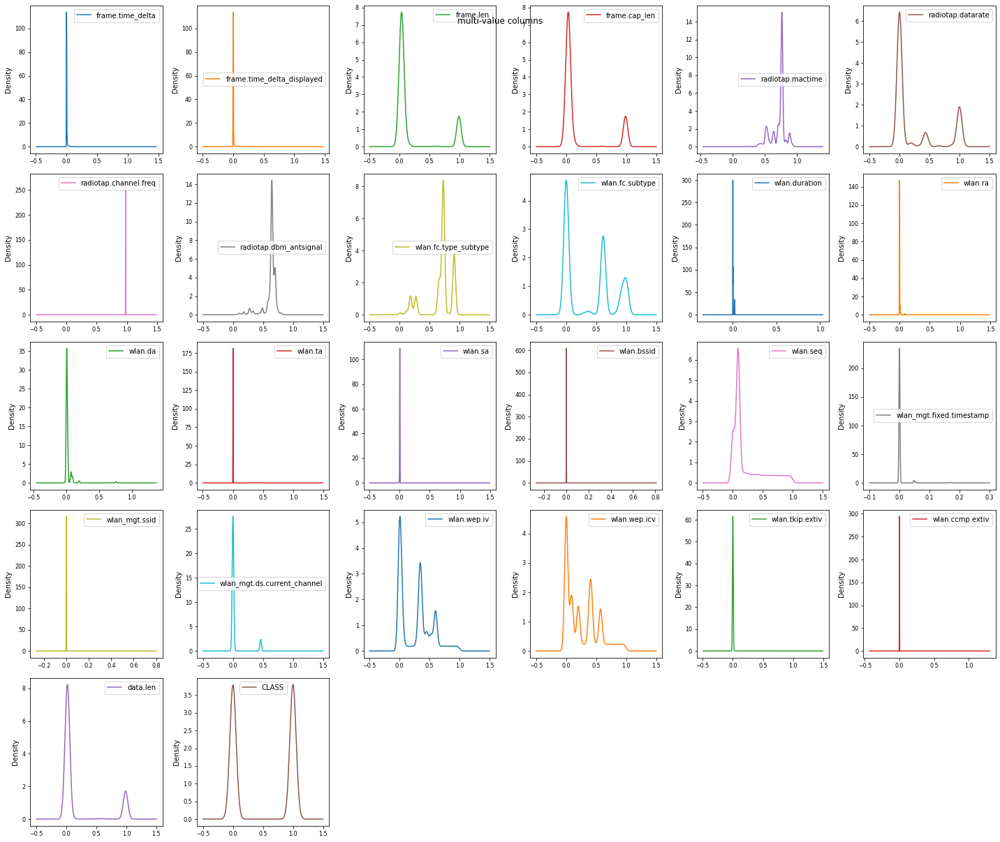

In [21]:
import matplotlib.pyplot as plt
from math import sqrt

#density plot function
def density (data, title):
    cols = data.columns
    collength = len(cols)
    gridsize = int(round(sqrt(collength), 0) + 1)
    data.plot(kind='density',
                  subplots=True,
                  layout=(gridsize, gridsize),
                  sharex=False,
                  legend=True,
                  figsize=(20, 20),
                  fontsize=8,)
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

#column categories
def colcat(data):
    single_value_columns = []
    binarizable_columns = []
    binnable_columns = []
    target_column = "CLASS"

    for i in columns:
      if (i != target_column):
        if data[i].nunique() == 1:
          single_value_columns.append(i)
        elif data[i].nunique() <= 6:
          binarizable_columns.append(i)
        else:
          binnable_columns.append(i)
  
    return(single_value_columns,
          binarizable_columns,
          binnable_columns,
          target_column)

single_value_columns,binarizable_columns,binnable_columns,target_column = \
colcat(X_train_as_df_w_class)

binnable_columns.append(target_column)
mv = X_train_as_df_w_class[binnable_columns]

density(mv,"multi-value columns")


We can see from looking at the multi-value colums that several have multiple values, but that they are comprised of a very small peak around "zero".

Some others are effective duplicates of each other (eg. frame.len and frame.cap_lan)

Others seem to contain a few meaningul peaks, with other values approaching the peak.

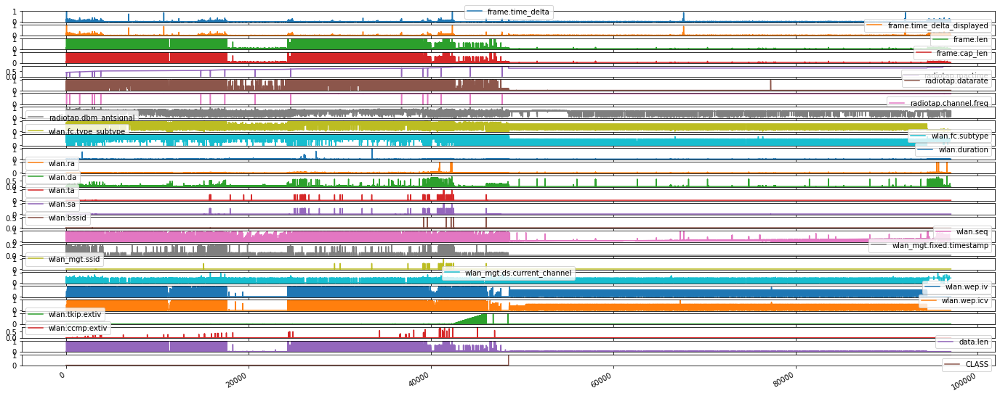

In [ ]:
df = train[binnable_columns]
df.plot(subplots=True, figsize=(24, 10))
plt.show()

Looking at the distribution of values (right-hand side showing CLASS = 1, and left hand side showing CLASS = 0), we can see the correlation between several of the variables: eg. frame.len, frame.cap_len, wlan.wep.iv, wlan.wep.icv, and data.len tend to return low values when CLASS = 1, but there is an exception for a set of obvservations (around the 20,000 mark) where the signal cuts out.

In [11]:
import time
t1 = time.perf_counter()

### Your code goes here ###
from sklearn.preprocessing import KBinsDiscretizer, Binarizer
import warnings
warnings.filterwarnings('ignore')

#Putting into 3 distinct bins
#encoding set to ordinal for consistency with other two-value items
adjusted = KBinsDiscretizer(strategy = "kmeans",n_bins = 3,encode="ordinal").fit_transform(df)
df = pd.DataFrame(data=adjusted, columns=binnable_columns)
df.plot(subplots=True, figsize=(24, 10))

t2 = time.perf_counter()
time_taken_for_3_bins = t2-t1
print(t2-t1)


NameError: ignored

splitting into 3 bins makes the signals clearer.

Variables with more than 6 values: number shown

In [ ]:
#Then converting into two values
adjusted = Binarizer(threshold =0).fit_transform(adjusted)
mvbindf = pd.DataFrame(data=adjusted, columns=binnable_columns)
mvbindf.plot(subplots=True, figsize=(10, 12))
plt.show()

Converting into two values simplifies further still.

Looking now at variables with fewer than 6:

We can see that among the items with fewer individual items, we get a few signals which appear during the "out" periods of otherwise reliable features.
Eg. When data.len is low and class is 0, then wlan_mgt.fixed.reason_code is high.



In [ ]:
cols = binarizable_columns + [target_column]
bdf = X_train[cols]
bdf = Binarizer(threshold =0).fit_transform(bdf)
bdf = pd.DataFrame(data=bdf, columns=cols)
bdf.plot(subplots=True, figsize=(10, 25))
plt.show()

##Semi-manual pre-processing

Features selected after binarizing and a variance threshold. Top 5 features selected based on mutual information.

The intuition here is that there may be a relatively simple solution available for binary classification, based on binarizing the data- perhaps via random forest data.

Many of the signals seem to be effectively "on" or "off", but can produce a very large number of signals.

In [44]:
from sklearn.preprocessing import Binarizer
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import VarianceThreshold
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif

#remove convergance warnings, which will creep in during binning.
from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

from sklearn import set_config
set_config(display="diagram")

#column categories
def colcat(data):
    single_value_columns = []
    binarizable_columns = []
    binnable_columns = []
    target_column = "CLASS"

    for i in columns:
      if (i != target_column):
        if data[i].nunique() == 1:
          single_value_columns.append(i)
        elif data[i].nunique() <= 6:
          binarizable_columns.append(i)
        else:
          binnable_columns.append(i)
  
    return(single_value_columns,
          binarizable_columns,
          binnable_columns,
          target_column)

single_value_columns,binarizable_columns,binnable_columns,target_column = \
colcat(X_train_as_df_w_class)

continuous_transformer = Pipeline\
(
    steps=[("place_into_bins", KBinsDiscretizer(strategy= "kmeans", n_bins = 3)),
           ("binarize", Binarizer(threshold=0))
])

binary_transformer = Pipeline\
(
    steps=[("re-form", StandardScaler()),
           ("binarize", Binarizer(threshold=0))]
)

initial_filter = VarianceThreshold(threshold=0.05)

def mutual_info(X, y):
    return mutual_info_classif(X, y, random_state=42)
f_selector = SelectKBest(score_func = mutual_info, k=5)

coltransformer = ColumnTransformer (transformers = [("binnables",continuous_transformer,binnable_columns),
                                                    ("binaries",binary_transformer,binarizable_columns)],remainder = "drop")

pipe1 = Pipeline(steps = [("ct",coltransformer),("vf",initial_filter),("mutual_info",f_selector)])



In [23]:
#fit the pipeline to the train data and give names for later appending
t1 = time.perf_counter()
X_train_top_5_bin_as_df = pd.DataFrame(pipe1.fit_transform(X_train_as_df,y_train),columns = ["5bestbinary"+str(i) for i in range(1,6)])
t2 = time.perf_counter()

X_validation_top_5_bin_as_df = pd.DataFrame(pipe1.fit_transform(X_validation_as_df,y_validation),columns = ["5bestbinary"+str(i) for i in range(1,6)])

X_test_top_5_bin_as_df = pd.DataFrame(pipe1.fit_transform(X_test_as_df,y_test),columns = ["5bestbinary"+str(i) for i in range(1,6)])


ttb_3 = t2-t1

X_train_top_5_bin_as_df

,5bestbinary1,5bestbinary2,5bestbinary3,5bestbinary4,5bestbinary5
0,1.0,1.0,1.0,0.0,1.0
1,0.0,0.0,0.0,1.0,0.0
2,1.0,1.0,1.0,0.0,1.0
3,0.0,0.0,0.0,1.0,0.0
4,1.0,1.0,1.0,0.0,1.0
5,1.0,0.0,1.0,0.0,0.0
6,1.0,0.0,1.0,0.0,0.0
7,1.0,1.0,1.0,0.0,0.0
8,0.0,0.0,0.0,1.0,0.0
9,0.0,0.0,0.0,1.0,0.0


In [24]:
#plot updated features
print("time to run",ttb_3)
t_df.head(5)
sted = t_df.sort_values(by="5bestbinary1", axis=0, ascending=True)
sted.plot(subplots=True,kind="hist")

time to run 20.135084940000013


NameError: ignored

#Feature Extraction



##PCA tuning
With any feature extraction process, it is important to include Principal Components Analysis ("PCA"), as a traditional and frequently utilized method. If nothing else, this provides a strong benchmark.

To begin with, I tune the PCA parameters with an SVM classifier.

The classifier is also tuned to identify the best kernel option, and this classifier will be used for other tuning. This potentially biases results towards PCA, but it *should* be hard to beat.

In [ ]:
from sklearn.decomposition import PCA, TruncatedSVD, NMF
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline

t1 = time.perf_counter()

pca = PCA(0.9,whiten=True,)
mms = MinMaxScaler(feature_range = (0,1))
svm = SVC(kernel="poly")

pipe = Pipeline(steps=[("pca",pca),("mms",mms),("svm",svm)])

param_grid = dict(
    pca__whiten=[True,False],
    pca__n_components=[0.75,0.90],
    svm__kernel=["poly","rbf","linear"]
)

grid_search = GridSearchCV(pipe, param_grid=param_grid, verbose=3, scoring="f1")

Optimisation was based on a Support Vector Machine, using a poly kernel.
PCA outputs were re-scaled to 0,1 afterwards just to maintain the scale elsewhere.

This suggested tolerance of 0.0, Whiten set to True.


In [ ]:
tuned = grid_search.fit(X_train,y_train)


Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=poly;, score=0.986 total time=  11.8s
[CV 2/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=poly;, score=0.986 total time=  12.0s
[CV 3/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=poly;, score=0.986 total time=  11.9s
[CV 4/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=poly;, score=0.988 total time=  11.8s
[CV 5/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=poly;, score=0.987 total time=  12.2s
[CV 1/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=rbf;, score=0.987 total time=  17.3s
[CV 2/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=rbf;, score=0.987 total time=  17.7s
[CV 3/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=rbf;, score=0.986 total time=  17.8s
[CV 4/5] END pca__n_components=0.75, pca__whiten=True, svm__kernel=rbf;, score=0.987 total time=  17.7

In [93]:
pd.DataFrame(tuned.cv_results_)

NameError: ignored

In [92]:
tuned.best_params_

NameError: ignored

In [ ]:
tuned.best_index_

6

##Checking different Component methods

I'm checking PCA against TruncatedSVD and NMF as transformation options.
These can be compared against each other, along with feature option steps. 

The values of "c" for the classifier are also set.

After a brief variance filter to reduce the number of columns that the algorithmic options have to work through, we set a comparison running.

for classification, a Support Vector Machine is used. The kernel is set to "poly"

In [ ]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA, NMF, KernelPCA, TruncatedSVD
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import VarianceThreshold

initial_filter = VarianceThreshold(threshold=0.05)

steps = [("i_f",initial_filter),
        ("reduce_dim", "passthrough"),
        ("classify",SVC(kernel="poly"))]

#This is done to reduce the number of features the more intensive algorithms have to work with
selection_pipe = Pipeline(steps=steps)

N_FEATURES_OPTIONS = [6]
C_OPTIONS = [1, 10]

from warnings import simplefilter
from sklearn.exceptions import ConvergenceWarning
simplefilter("ignore", category=ConvergenceWarning)

param_grid = [{
        "reduce_dim":[PCA(0.9), 
                      NMF(init = "nndsvdar", max_iter =500), 
                      TruncatedSVD(algorithm='arpack')],
        "reduce_dim__n_components": N_FEATURES_OPTIONS,
        "classify__C": C_OPTIONS,
    }]

reducer_labels = ["PCA", "NMF", "Truncated_SVD"]

grid = GridSearchCV(selection_pipe, param_grid=param_grid,verbose = 3)
print("fitting_grid")

grid.fit(X_train, y_train)

In [ ]:
"variations"
mean_scores = np.array(grid.cv_results_["mean_test_score"])
# scores are in the order of param_grid iteration, which is alphabetical
mean_scores = mean_scores.reshape(len(C_OPTIONS), -1, len(N_FEATURES_OPTIONS))
# select score for best C
mean_scores = mean_scores.max(axis=0)
bar_offsets = np.arange(len(N_FEATURES_OPTIONS)) * (len(reducer_labels) + 1) + 0.5

import matplotlib.pyplot as plt

plt.figure()
COLS = ["hotpink","peru","indigo"]
for i, (label, reducer_scores) in enumerate(zip(reducer_labels, mean_scores)):
    plt.bar(bar_offsets + i, reducer_scores, label=label, color=COLORS[i])

plt.title("Comparing feature reduction techniques")
plt.xlabel("Reduced number of features")
plt.xticks(bar_offsets + len(reducer_labels) / 2, N_FEATURES_OPTIONS)
plt.ylabel("Digit classification accuracy")
plt.ylim((0, 1))
plt.legend(loc="upper left")

plt.show()

##PCA Implementation

The optimised PCA settings are used for PCA fitting on the train set.

In [26]:
from sklearn.decomposition import PCA
import time

pca = PCA(0.9,whiten=True,tol=0.0)
t1 = time.perf_counter()
pca.fit(X_train)
t2 = time.perf_counter()

time_to_fit_pca = t2-t1
print("time to fit pca =", time_to_fit_pca)
print("n_features",pca.n_features_)
print("noise_variance",pca.noise_variance_)
print("explained variance",pca.explained_variance_)
print("explained variance ratio",pca.explained_variance_ratio_)

cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.90) + 1

time to fit pca = 0.9240762570000243
n_features 152
noise_variance 0.001446764196037366
explained variance [1.02142293 0.86237929 0.25416582 0.1228525  0.10198592 0.06227727]
explained variance ratio [0.38744398 0.32711588 0.09640964 0.04660015 0.03868508 0.02362288]


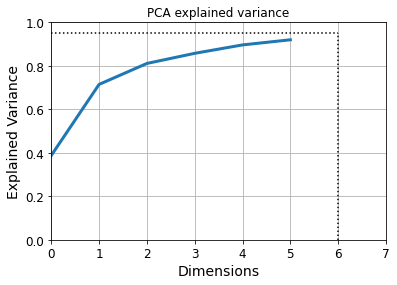

In [27]:
import matplotlib as mpl
import matplotlib.pyplot as plt
#this code from https://colab.research.google.com/github/ageron/handson-ml2/blob/master/08_dimensionality_reduction.ipynb#scrollTo=XRVKTDbb9cU5
%matplotlib inline
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

plt.figure(figsize=(6,4))
plt.plot(cumsum, linewidth=3)
plt.axis([0, 7, 0, 1])
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.plot([d, d], [0, 0.95], "k:")
plt.plot([0, d], [0.95, 0.95], "k:")
plt.title("PCA explained variance")
plt.grid(True)
plt.show()


Fitting PCA to the various data sets. NB, the transformations are applied to the validation and test sets, but the validation and test sets aren't used in training.

A min-max scaler (0-1) is applied as an extra transformation. This keeps it in scale with the rest of the features.

In [28]:
from sklearn.preprocessing import MinMaxScaler

mms = MinMaxScaler()

X_train_PCA = mms.fit_transform(pca.transform(X_train))
X_validation_PCA = mms.fit_transform((pca.transform(X_validation)))
X_test_PCA = mms.fit_transform((pca.transform(X_test)))

print("X_train_PCA_shape",X_train_PCA.shape)
print("X_validation_PCA_shape",X_validation_PCA.shape)
print("X_test_PCA_shape",X_test_PCA.shape)


X_train_PCA_shape (77635, 6)
X_validation_PCA_shape (19409, 6)
X_test_PCA_shape (40158, 6)


We can visualise the Principal components on the training data. Interestingly, the "1" (attack) items appear in certain small areas, but which may prove difficult to distinguish linearly.

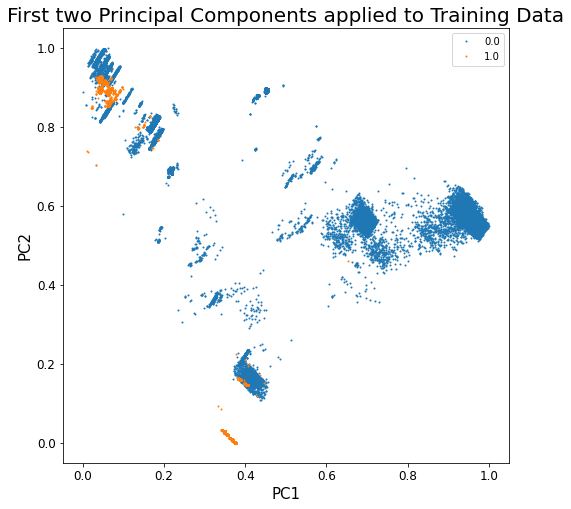

In [29]:
PCA_and_Class_label_train = np.concatenate(
    (X_train_PCA, y_train[:, np.newaxis]), axis=1)
PCA_and_Class_label_train = pd.DataFrame(
    PCA_and_Class_label_train, columns = 
             ["PC1","PC2","PC3","PC4","PC5","PC6","CLASS"])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('PC1', fontsize = 15)
ax.set_ylabel('PC2', fontsize = 15)
ax.set_title('First two Principal Components applied to Training Data', 
             fontsize = 20)
groups = PCA_and_Class_label_train.groupby('CLASS')
for name, group in groups:
    plt.plot(group.PC1, group.PC2, marker='o', linestyle='', 
             markersize=1, label=name)
plt.legend()
plt.show()

Now the Principal Components are applied to all the datasets.

In [31]:
X_train_with_PCA_added = np.concatenate((X_train, X_train_PCA), axis=1)
X_validation_with_PCA_added = np.concatenate((X_validation, X_validation_PCA), axis=1)
X_test_with_PCA_added = np.concatenate((X_test, X_test_PCA), axis=1)

for i in ["PC1","PC2","PC3","PC4","PC5","PC6"]:
  if i not in columns_without_class_label:
    columns_without_class_label.append(i)

X_train_with_pca_as_df= pd.DataFrame(X_train_with_PCA_added,
                                     columns=columns_without_class_label)
X_validation_with_pca_as_df= pd.DataFrame(X_validation_with_PCA_added,
                                          columns=columns_without_class_label)
X_test_with_pca_as_df= pd.DataFrame(X_test_with_PCA_added,
                                    columns=columns_without_class_label)

print("X_train_PCA_appended_shape",X_train_with_pca_as_df.shape)
print("X_validation_PCA_appended_shape",X_validation_with_pca_as_df.shape)
print("X_test_PCA_appended_shape",X_test_with_pca_as_df.shape)

X_train_PCA_appended_shape (77635, 158)
X_validation_PCA_appended_shape (19409, 158)
X_test_PCA_appended_shape (40158, 158)


##Neighbourhood Component Analysis

An alternative approach to Principal Components is using Neighborhood Component Analysis. This can have the benefit of explicitly attempting to transform the data so that common clusters are closer to one another. This can then help with k-nearest-neighbours, or indeed other, classification techniques.

But as an iterative technique, and computationally quite expensive.

"Many metric
learning algorithms are ...  based on the point estimation
of a quadratic optimization problem", and can be susceptible to overfitting.

https://arxiv.org/pdf/1604.02354.pdf/
D. Wang and X. Tan, "Bayesian Neighborhood Component Analysis," in IEEE Transactions on Neural Networks and Learning Systems, vol. 29, no. 7, pp. 3140-3151, July 2018, doi: 10.1109/TNNLS.2017.2712823.

One proposal in this paper is a more Bayesian approach, but that's not taken here.


In [ ]:
from sklearn.neighbors import NeighborhoodComponentsAnalysis

'''This needs to be fit on a sub-set of the training data- 
otherwise the process will take far too long or the system 
will be overwhelmed.'''
np.random.seed(42)
indices = np.random.choice(X_train.shape[0], 10000, replace=False)
small = X_train[indices]

#No fine tuning done on this yet- will do so if it makes the cut.
nca = NeighborhoodComponentsAnalysis(random_state=42,
                                     n_components = 3, 
                                     verbose = 2)





In [ ]:
#Fit the model
t1 = time.perf_counter()
nca_model = nca.fit(small,y_train[indices])
t2 = time.perf_counter()

time_taken_to_fit_Neighbourhood_Components = t2 - t1
print(time_taken_to_fit_Neighbourhood_Components)

In [ ]:
#Apply the model to the various datasets


#train
X_train_NCA_transformed = nca_model.transform(X_train)
X_train_NCA_transformed = mms.fit_transform(X_train_NCA_transformed)
X_train_NCA_as_df = pd.DataFrame(data = X_train_NCA_transformed, 
                                 columns = 
                                 ['n1', 'n2','n3'])

#validation
X_validation_NCA_transformed = nca_model.transform(X_validation)
X_validation_NCA_transformed = mms.fit_transform(X_validation_NCA_transformed)
X_validation_NCA_as_df = pd.DataFrame(data = X_validation_NCA_transformed, 
                                      columns = 
                                      ['n1', 'n2','n3'])

#test
X_test_NCA_transformed = nca_model.transform(X_test)
X_test_NCA_transformed = mms.fit_transform(X_test_NCA_transformed)
X_test_NCA_as_df = pd.DataFrame(data = X_test_NCA_transformed, 
                                columns = 
                                      ['n1', 'n2','n3'])


print("NCA train set shape",X_train_NCA_transformed.shape)
print("NCA train set shape",X_validation_NCA_transformed.shape)
print("NCA train set shape",X_test_NCA_transformed.shape)




#For visualisation, add in the Class label.
X_train_NCA_as_df_w_class_label = pd.concat([X_train_NCA_as_df, 
                                             X_train_as_df_w_class["CLASS"]], 
                                            axis = 1)

X_train_NCA_as_df


Plot Neighbourhood Component Analysis

In [ ]:
fig = plt.figure(figsize = (16,15))
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('dim1', fontsize = 15)
ax.set_ylabel('dim2', fontsize = 15)
ax.set_ylabel('dim3', fontsize = 15)
ax.set_title('3 features of NeighborhoodComponentAnalysis, applied to the training data'
, fontsize = 20)
X_train_NCA_as_df_w_class_label["CLASS"].replace({0.0: "normal", 1.0: "attack"},
                                                 inplace=True)
groups = X_train_NCA_as_df_w_class_label.groupby('CLASS')
colr = {"normal":"steelblue","attack":"peru"}
for name, group in groups:
    plt.plot(group.n1, group.n2, group.n3, marker='o', linestyle='', 
             markersize=1, label=name,color=colr[name])
plt.legend()
plt.show()


##Alternative approach: Manifold learning - Locally Linear Embedding
Locally Linear Embedding can sometimes be successful because it identifies linear trends in high-dimensional datasets that might otherwise not make it available.

In [ ]:
from sklearn.manifold import LocallyLinearEmbedding

#Eigen Solver set to dense as this isn't a sparse dataset.
#Two components chosen as the strength is in forming simple linearity.
LLE_1 = LocallyLinearEmbedding(n_components=2, eigen_solver='dense',random_state=42)



Fit the model - takes more than two minutes.

In [ ]:
#A subset of train data (10,000 long) used for training, to keep computation time relatively low
np.random.seed(42)
indices = np.random.choice(X_train.shape[0], 10000, replace=False)
small = X_train[indices]

#start timing
t1 = time.perf_counter()
#fit the data
LLE_model = LLE_1.fit(small)
#end timing
t2 = time.perf_counter()
#time counter
time_to_fit_LLE_1 = t2-t1
print("manifold LLE time to fit=",time_to_fit_LLE_1)

Apply the model to the datasets

In [ ]:
#train set transformations. NB "mms" is the min max scaler transformation
t1 = time.perf_counter()

X_train_LLE_Transformed = LLE_model.transform(X_train)
X_train_LLE_Transformed = mms.fit_transform(X_train_LLE_Transformed)

t2 = time.perf_counter()
time_to_transform_LLE_train = t2 - t1
print("time to transform LLE train set",time_to_transform_LLE_train)

#validation set transformations
X_validation_LLE_Transformed = LLE_model.transform(X_validation)
X_validation_LLE_Transformed = mms.fit_transform(X_validation_LLE_Transformed)

#test set transformations
X_test_LLE_Transformed = LLE_model.transform(X_test)
X_test_LLE_Transformed = mms.fit_transform(X_test_LLE_Transformed)


X_train_LLE_Transformed_as_df = pd.DataFrame(data = X_train_LLE_Transformed, 
                           columns = ['LLE1','LLE2'])

X_validation_LLE_Transformed_as_df = pd.DataFrame(data = X_validation_LLE_Transformed, 
                           columns = ['LLE1','LLE2'])

X_test_LLE_Transformed_as_df = pd.DataFrame(data = X_test_LLE_Transformed, 
                           columns = ['LLE1','LLE2'])

X_train_LLE_Transformed_as_df

Plot LLE. This creates a very different sort of output from the others.

In [ ]:
#plot the Manifold approach.


nbr_w_class_label = pd.concat([X_train_LLE_Transformed_as_df, X_train_as_df_w_class["CLASS"]], 
                              axis = 1)
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('dim1', fontsize = 15)
ax.set_ylabel('dim2', fontsize = 15)
ax.set_title('2 features from LLE', fontsize = 20)
nbr_w_class_label["CLASS"].replace({0.0: "normal", 1.0: "attack"}, inplace=True)
groups = nbr_w_class_label.groupby('CLASS')
colr = {"normal":"steelblue","attack":"peru"}
for name, group in groups:
    plt.plot(group.LLE1, 
             group.LLE2, 
             marker='x', 
             linestyle='', 
             markersize=1, 
             label=name,
             color=colr[name])
plt.legend()
plt.show()

Let's also try fitting the LLE model to the NCA

In [ ]:
LLE_2 = LocallyLinearEmbedding(n_components=2, eigen_solver='dense',
                               random_state= 42)

t1 = time.perf_counter()

indices = np.random.choice(X_train.shape[0], 10000, replace=False)
small_NCA = X_train_NCA_transformed[indices]

LLE_NCA_ensemble = LLE_2.fit(small_NCA)

t2 = time.perf_counter()
time_to_fit_LLE_2 = t2 -t1
print("manifold LLE time to fit on NCA set",time_to_fit_LLE_2)

In [ ]:
#train set transformations. NB "mms" is the min max scaler transformation
t1 = time.perf_counter()

X_train_LLE_2_Transformed = LLE_NCA_ensemble.transform(X_train_NCA_transformed)
X_train_LLE_2_Transformed = mms.fit_transform(X_train_LLE_2_Transformed)

t2 = time.perf_counter()
time_to_transform_LLE_2_train = t2 - t1
print("time to transform LLE (2) train set",time_to_transform_LLE_2_train)

#validation set transformations
X_validation_LLE_2_Transformed = LLE_NCA_ensemble.transform(X_validation_NCA_transformed)
X_validation_LLE_2_Transformed = mms.fit_transform(X_validation_LLE_2_Transformed)

#test set transformations
X_test_LLE_2_Transformed = LLE_NCA_ensemble.transform(X_test_NCA_transformed)
X_test_LLE_2_Transformed = mms.fit_transform(X_test_LLE_2_Transformed)

X_train_LLE_2_Transformed_as_df = pd.DataFrame(data = X_train_LLE_2_Transformed, 
                           columns = ['LLE_2_1','LLE_2_2'])

X_validation_LLE_2_Transformed_as_df = pd.DataFrame(data = X_validation_LLE_2_Transformed, 
                           columns = ['LLE_2_1','LLE_2_2'])

X_test_LLE_2_transformed_as_df = pd.DataFrame(data = X_test_LLE_2_Transformed, 
                           columns = ['LLE_2_1','LLE_2_2'])

X_train_LLE_2_Transformed_as_df

PLot ensemble approach - this perhaps looks a little better, but largely the same

In [ ]:
#Plot the ensemble approach


nbr_w_class_label = pd.concat([X_train_LLE_2_Transformed_as_df, X_train_as_df_w_class["CLASS"]], 
                              axis = 1)
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('dim1', fontsize = 15)
ax.set_ylabel('dim2', fontsize = 15)
ax.set_title('2 features from LLE', fontsize = 20)
nbr_w_class_label["CLASS"].replace({0.0: "normal", 1.0: "attack"}, inplace=True)
groups = nbr_w_class_label.groupby('CLASS')
colr = {"normal":"steelblue","attack":"peru"}
for name, group in groups:
    plt.plot(group.LLE_2_1, 
             group.LLE_2_2, 
             marker='x', 
             linestyle='', 
             markersize=1, 
             label=name,
             color=colr[name])
plt.legend()
plt.show()


Apply the LLE embeddings to the datasets- independently and together.
NB the LLE model is quite slow to fit, compared with other models.

Concatenate the remaining transformed features

##TSNE visualisations

"t-distributed Stochastic Neighbor Embedding" is useful for visualising the seperation achieved by dimensionality reduction, and gauging which models might form useful classifiers.

It encourages observations to be relatively closely spaced. In this case, I am performing it on the transformed features projected onto the principal components.


In [ ]:
#visualisation from https://towardsdatascience.com/why-you-are-using-t-sne-wrong-502412aab0c0
#plot the new features, using TSNE to show representation

def visualise_t_SNE(data=X_train):
  from sklearn.manifold import TSNE
  import seaborn as sns

  # randomly sample data to run quickly
  np.random.seed(42)
  indices = np.random.choice(data.shape[0], 10000, replace=False)
  
  # reduce dimensionality with t-sne
  small = data[indices]

  tsne = TSNE(n_components=2, verbose=1, perplexity=50, n_iter=1000, learning_rate=200)
  tsne_results = tsne.fit_transform(small)
  df_tsne = pd.DataFrame(tsne_results, columns=['comp1', 'comp2'])
  df_tsne['CLASS'] = y_train[indices]
  sns.lmplot(x='comp1', y='comp2', data=df_tsne, hue='CLASS', palette= "pastel", fit_reg=False)

##Autoencoder for dimensionality reduction
Autoencoders are a type of neural network, in which the output resembles the input, having been reduced in dimensions. 

The first part of the network (the encoder) can be used 

Here, the implementation uses a bottleneck of 30 to create a simplified version of the dataset. This is a smaller number than used by Parker et al.



Learn rate and batch size reduced from initial 0.1 and 8, and epochs increased to 30 from 10. With too large a jump, the stacked autoencoder got highly mislead.

In [25]:
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras.models import Model
from tensorflow.keras import callbacks
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
from tensorflow.keras.regularizers import l1
from tensorflow.keras import optimizers
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras import Input

def rounded_accuracy(y_true, y_pred):
    return keras.metrics.binary_accuracy(tf.round(y_true), tf.round(y_pred))
early_stopping_cb = keras.callbacks.EarlyStopping(patience = 15, restore_best_weights= True)

n_inputs=152
shape = (152,)
learning_rate=0.01
tf.random.set_seed(42)

#input layer
input_layer = Input(shape=shape)

#encoder layer1
encoder = Dense (100, activation="selu",kernel_initializer="lecun_normal")(input_layer)
encoder = BatchNormalization()(encoder)
#encoder layer2
encoder = Dense (50, activation="selu",kernel_initializer="lecun_normal")(input_layer)
encoder = BatchNormalization()(encoder)
#bottleneck
encoder = Dense (20, activation="selu",kernel_initializer="lecun_normal")(input_layer)
encoder = BatchNormalization()(encoder)
bottleneck = Dense(20)(encoder)

#decoder layer1
decoder = Dense(50)(bottleneck)
decoder = BatchNormalization()(decoder)
#decoder layer2
decoder = Dense(100)(bottleneck)
decoder = BatchNormalization()(decoder)
#output layer
output = Dense(152, activation='sigmoid')(decoder)

sae_model = Model(inputs=input_layer, outputs=output)
sae_model.compile(optimizer='adamax', loss='binary_crossentropy')

plot_model(model, 'autoencoder_no_compress.png', show_shapes=True)


history = model.fit(X_train, X_train, epochs=30, batch_size=8, verbose=2, 
                    validation_data=(X_validation,X_validation))

#visualise loss by epoch
plt.plot(history_1.history['loss'], label='train')
plt.plot(history_1.history['val_loss'], label='validation')
plt.suptitle('autoencoder compilation- Adamax optimizer, 30 epochs')
plt.legend()
plt.show()


AttributeError: ignored

In [219]:
encoder_model = Model(inputs=input_layer, outputs=bottleneck)
SAE_data_1= encoder_model.predict(X_train)

encoder_cols = ["Encoded_feature "+str(int((i+1))) for i in range(0,20)]

X_train_encoder_features = (mms.fit_transform(SAE_data_1))
X_train_encoder_features_as_df = pd.DataFrame(X_train_encoder_features,columns = encoder_cols)
X_train_encoder_features_as_df

,Encoded_feature 1,Encoded_feature 2,Encoded_feature 3,Encoded_feature 4,Encoded_feature 5,Encoded_feature 6,Encoded_feature 7,Encoded_feature 8,Encoded_feature 9,Encoded_feature 10,Encoded_feature 11,Encoded_feature 12,Encoded_feature 13,Encoded_feature 14,Encoded_feature 15,Encoded_feature 16,Encoded_feature 17,Encoded_feature 18,Encoded_feature 19,Encoded_feature 20
0,0.732138,0.514810,0.587848,0.406703,0.738502,0.408463,0.395752,0.380306,0.364444,0.305078,0.473188,0.904648,0.633022,0.418779,0.500534,0.622504,0.392965,0.795460,0.274331,0.359145
1,0.571873,0.619287,0.358788,0.702937,0.536069,0.449239,0.631907,0.741297,0.459343,0.331281,0.361362,0.576667,0.732238,0.254047,0.537045,0.490202,0.199669,0.117870,0.567684,0.394626
2,0.678273,0.551894,0.581433,0.423395,0.704488,0.379500,0.344251,0.414418,0.384614,0.292724,0.407254,0.887402,0.621557,0.427371,0.529983,0.607749,0.454958,0.791684,0.255267,0.378617
3,0.453075,0.663017,0.323564,0.744461,0.665019,0.551496,0.399922,0.530180,0.343705,0.257848,0.507128,0.655275,0.583174,0.408146,0.315358,0.396432,0.269413,0.306385,0.610752,0.458515
4,0.726883,0.513142,0.588147,0.402130,0.737197,0.400336,0.407156,0.383425,0.358905,0.302450,0.472572,0.902996,0.633817,0.413527,0.506321,0.620600,0.395265,0.800129,0.267305,0.363020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77630,0.563351,0.636305,0.336251,0.707427,0.536519,0.504537,0.618551,0.765622,0.456735,0.305873,0.395298,0.563059,0.724090,0.276562,0.515820,0.474471,0.207872,0.092035,0.608783,0.409572
77631,0.663879,0.519341,0.607111,0.482048,0.695615,0.375945,0.325818,0.385307,0.395786,0.332702,0.398890,0.873675,0.632940,0.425793,0.506398,0.584666,0.430177,0.741836,0.265933,0.404579
77632,0.760021,0.492651,0.596117,0.400017,0.756279,0.418065,0.421262,0.356520,0.358980,0.319375,0.507668,0.913291,0.636509,0.420146,0.484607,0.633474,0.355587,0.802694,0.278438,0.350661
77633,0.546323,0.631359,0.322855,0.692216,0.524900,0.488950,0.652836,0.780288,0.432708,0.297071,0.407421,0.543249,0.720724,0.255891,0.530687,0.467417,0.214293,0.101744,0.620069,0.419118


Converting the most promising SAE features to DF

In [222]:
encoder_cols = ["Encoded_feature "+str(int((i+1))) for i in range(0,20)]

SAE_data_2= encoder_model.predict(X_validation)
encoder_cols = ["Encoded_feature "+str(int((i+1))) for i in range(0,20)]
X_validation_encoder_features = (mms.fit_transform(SAE_data_2))
X_validation_encoder_features_as_df = pd.DataFrame(X_validation_encoder_features,columns = encoder_cols)

SAE_data_3= encoder_model.predict(X_test)
encoder_cols = ["Encoded_feature "+str(int((i+1))) for i in range(0,20)]
X_test_encoder_features = (mms.fit_transform(SAE_data_2))
X_test_encoder_features_as_df = pd.DataFrame(X_test_encoder_features,columns = encoder_cols)


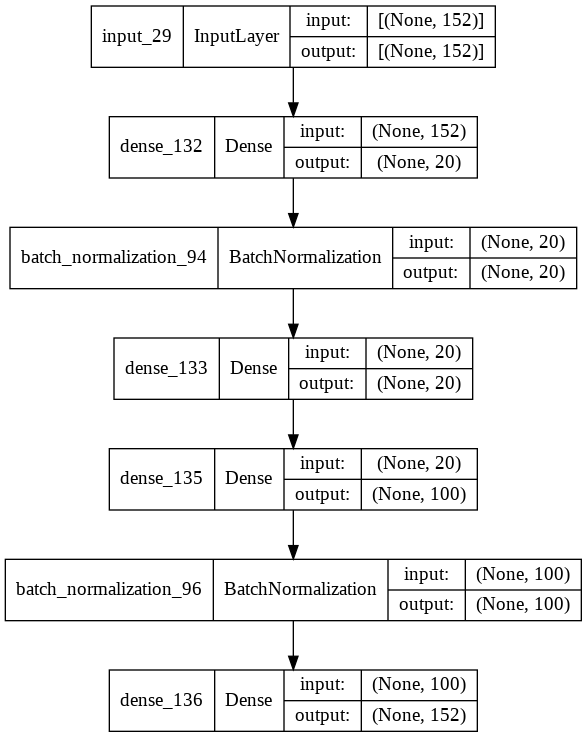

In [223]:
from tensorflow.keras.utils import plot_model
plot_model(sae_model, show_shapes=True)

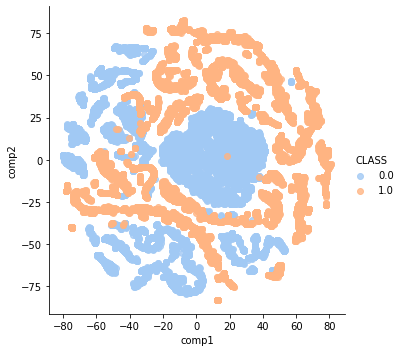

In [136]:
visualise_t_SNE(data=X_train_NCA_transformed)

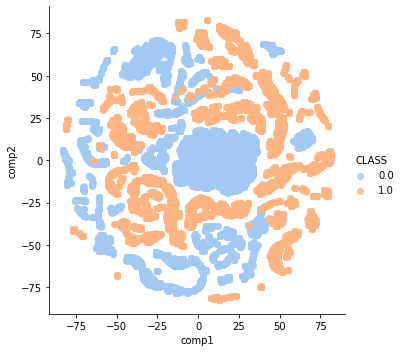

In [132]:
visualise_t_SNE(data=X_train_PCA)

the encoder looks quite similar to PCA

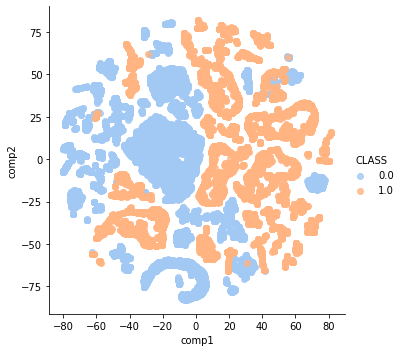

In [187]:
visualise_t_SNE(data=SAE_data_1)

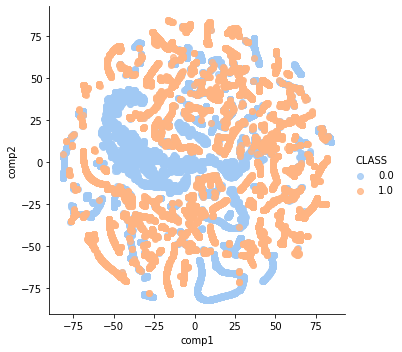

In [137]:
visualise_t_SNE(data=X_train_LLE_2_Transformed)

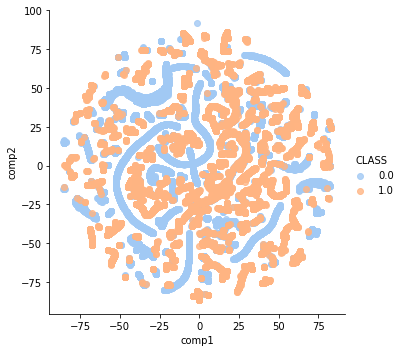

In [133]:
visualise_t_SNE(data=X_train_LLE_Transformed)

##Full concatenation of different feature generation approaches

In [227]:
X_train_with_all_transformations = pd.concat([X_train_with_pca_as_df,
                                        X_train_LLE_Transformed_as_df,
                                        X_train_LLE_2_Transformed_as_df,
                                        X_train_NCA_as_df,
                                        X_train_top_5_bin_as_df,
                                        X_train_encoder_features_as_df
                                        ],axis = 1)



X_train_with_all_transformations.to_csv("/content/drive/MyDrive/AML Data/X_train_with_all_transformations.csv")
X_train_with_all_transformations



,frame.interface_id,frame.dlt,frame.offset_shift,frame.time_delta,frame.time_delta_displayed,frame.len,frame.cap_len,frame.marked,frame.ignored,radiotap.version,radiotap.pad,radiotap.length,radiotap.present.tsft,radiotap.present.flags,radiotap.present.rate,radiotap.present.channel,radiotap.present.fhss,radiotap.present.dbm_antsignal,radiotap.present.dbm_antnoise,radiotap.present.lock_quality,radiotap.present.tx_attenuation,radiotap.present.db_tx_attenuation,radiotap.present.dbm_tx_power,radiotap.present.antenna,radiotap.present.db_antsignal,radiotap.present.db_antnoise,radiotap.present.rxflags,radiotap.present.xchannel,radiotap.present.mcs,radiotap.present.ampdu,radiotap.present.vht,radiotap.present.reserved,radiotap.present.rtap_ns,radiotap.present.vendor_ns,radiotap.present.ext,radiotap.mactime,radiotap.flags.cfp,radiotap.flags.preamble,radiotap.flags.wep,radiotap.flags.frag,...,SECOND_wlan.qos.buf_state_indicated,data.len,PC1,PC2,PC3,PC4,PC5,PC6,LLE1,LLE2,LLE_2_1,LLE_2_2,n1,n2,n3,5bestbinary1,5bestbinary2,5bestbinary3,5bestbinary4,5bestbinary5,Encoded_feature 1,Encoded_feature 2,Encoded_feature 3,Encoded_feature 4,Encoded_feature 5,Encoded_feature 6,Encoded_feature 7,Encoded_feature 8,Encoded_feature 9,Encoded_feature 10,Encoded_feature 11,Encoded_feature 12,Encoded_feature 13,Encoded_feature 14,Encoded_feature 15,Encoded_feature 16,Encoded_feature 17,Encoded_feature 18,Encoded_feature 19,Encoded_feature 20
0,0.0,0.0,0.0,0.004091,0.004091,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.75774,0.0,0.0,0.0,0.0,...,0.0,0.023873,0.369134,0.008287,0.365215,0.376926,0.600833,0.370267,0.778413,0.500451,0.242738,0.307372,0.421120,0.158147,0.355861,1.0,1.0,1.0,0.0,1.0,0.732138,0.514810,0.587848,0.406703,0.738502,0.408463,0.395752,0.380306,0.364444,0.305078,0.473188,0.904648,0.633022,0.418779,0.500534,0.622504,0.392965,0.795460,0.274331,0.359145
1,0.0,0.0,0.0,0.002355,0.002355,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.73205,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.453360,0.887980,0.004217,0.202168,0.465577,0.320581,0.775676,0.512464,0.231306,0.309953,0.411095,0.430932,0.093199,0.0,0.0,0.0,1.0,0.0,0.571873,0.619287,0.358788,0.702937,0.536069,0.449239,0.631907,0.741297,0.459343,0.331281,0.361362,0.576667,0.732238,0.254047,0.537045,0.490202,0.199669,0.117870,0.567684,0.394626
2,0.0,0.0,0.0,0.005927,0.005927,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.76463,0.0,0.0,0.0,0.0,...,0.0,0.023873,0.356320,0.021209,0.353880,0.372088,0.626318,0.337285,0.779820,0.520391,0.240092,0.306359,0.364378,0.126610,0.354380,1.0,1.0,1.0,0.0,1.0,0.678273,0.551894,0.581433,0.423395,0.704488,0.379500,0.344251,0.414418,0.384614,0.292724,0.407254,0.887402,0.621557,0.427371,0.529983,0.607749,0.454958,0.791684,0.255267,0.378617
3,0.0,0.0,0.0,0.001879,0.001879,0.054902,0.054902,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.72023,0.0,0.0,0.0,0.0,...,0.0,0.039788,0.688974,0.579074,0.207601,0.268161,0.245091,0.675310,0.783394,0.520929,0.241258,0.306365,0.621187,0.618956,0.306107,0.0,0.0,0.0,1.0,0.0,0.453075,0.663017,0.323564,0.744461,0.665019,0.551496,0.399922,0.530180,0.343705,0.257848,0.507128,0.655275,0.583174,0.408146,0.315358,0.396432,0.269413,0.306385,0.610752,0.458515
4,0.0,0.0,0.0,0.017607,0.017607,0.037908,0.037908,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.75570,0.0,0.0,0.0,0.0,...,0.0,0.023873,0.369687,0.008005,0.364617,0.376258,0.600932,0.370966,0.781256,0.487277,0.231568,0.281762,0.423364,0.160014,0.357183,1.0,1.0,1.0,0.0,1.0,0.726883,0.513142,0.588147,0.402130,0.737197,0.400336,0.407156,0.383425,0.358905,0.302450,0.472572,0.902996,0.633817,0.413527,0.506321,0.620600,0.

#Feature Selection

##Univariate Selection- chi2

In [208]:
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectKBest

kbest = SelectKBest(chi2, k=20)
kbest.fit_transform(X_train_with_all_transformations,y_train)

print("-------")
print("top 20")
print("-------")
for i in kbest.get_feature_names_out():
  print(i)

print("-------")
print("top 10")
print("-------")
kbest = SelectKBest(chi2, k=10)
kbest.fit_transform(X_train_with_all_transformations,y_train)
for i in kbest.get_feature_names_out():
  print(i)
print("-------")
print("top 5")
print("-------")
kbest = SelectKBest(chi2, k=5)
kbest.fit_transform(X_train_with_all_transformations,y_train)
for i in kbest.get_feature_names_out():
  print(i)

-------
top 20
-------
frame.len
frame.cap_len
radiotap.datarate
radiotap.channel.type.cck
radiotap.channel.type.ofdm
wlan.fc.subtype
wlan.fc.ds
wlan.fc.retry
wlan.fc.pwrmgt
wlan.fc.protected
wlan.seq
data.len
PC2
n2
5bestbinary1
5bestbinary2
5bestbinary3
5bestbinary4
5bestbinary5
Encoded_feature 18
-------
top 10
-------
radiotap.datarate
radiotap.channel.type.ofdm
wlan.fc.subtype
wlan.fc.pwrmgt
data.len
PC2
5bestbinary2
5bestbinary3
5bestbinary4
5bestbinary5
-------
top 5
-------
radiotap.channel.type.ofdm
wlan.fc.pwrmgt
5bestbinary2
5bestbinary4
5bestbinary5


In [209]:
from sklearn.feature_selection import SelectKBest

def mutual_info(X, y):
    return mutual_info_classif(X, y, random_state=42)

kbest = SelectKBest(score_func = mutual_info, k=20)
kbest.fit_transform(X_train_with_all_transformations,y_train)

print("-------")
print("top 20")
print("-------")
for i in kbest.get_feature_names_out():
  print(i)

print("-------")
print("top 10")
print("-------")
kbest = SelectKBest(score_func = mutual_info, k=10)
kbest.fit_transform(X_train_with_all_transformations,y_train)
for i in kbest.get_feature_names_out():
  print(i)
print("-------")
print("top 5")
print("-------")
kbest = SelectKBest(score_func = mutual_info, k=5)
kbest.fit_transform(X_train_with_all_transformations,y_train)
for i in kbest.get_feature_names_out():
  print(i)

-------
top 20
-------
frame.len
frame.cap_len
radiotap.mactime
wlan.seq
wlan.wep.iv
wlan.wep.icv
PC1
PC2
PC3
PC4
PC5
Encoded_feature 2
Encoded_feature 5
Encoded_feature 9
Encoded_feature 12
Encoded_feature 13
Encoded_feature 14
Encoded_feature 15
Encoded_feature 18
Encoded_feature 20
-------
top 10
-------
frame.len
frame.cap_len
radiotap.mactime
PC1
PC2
PC3
PC4
PC5
Encoded_feature 2
Encoded_feature 12
-------
top 5
-------
frame.len
radiotap.mactime
PC1
PC2
PC3


##Wrapper Based Feature Selection

Too slow to build- use Logistic Regression instead

In [ ]:
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.datasets import make_classification

svc = SVC(kernel="linear",C=0.1)
#at this point, we're looking to see how many of the new features make it in.
#the poly kernel has been positive before
min_features_to_select = 20 

estimator = svc
selector = RFECV(estimator, step=0.1, cv=3, scoring = "accuracy", min_features_to_select=20)
selector = selector.fit(X_train_with_all_transformations, y_train)


In [ ]:
Logistic Regression Test

In [261]:
#some of code from https://mlwhiz.com/blog/2019/08/07/feature_selection/
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
rfe_selector_20 = RFE(estimator=LogisticRegression(), n_features_to_select=20, step=6)
rfe_selector_20.fit(X_train_with_all_transformations, y_train)
rfe_support_20 = rfe_selector.get_support()

rfe_selector_10 = RFE(estimator=LogisticRegression(), n_features_to_select=10, step=6)
rfe_selector_10.fit(X_train_with_all_transformations, y_train)
rfe_support_10 = rfe_selector.get_support()

rfe_selector_5 = RFE(estimator=LogisticRegression(), n_features_to_select=5, step=6)
rfe_selector_5.fit(X_train_with_all_transformations, y_train)
rfe_support_5 = rfe_selector.get_support()



Fitting estimator with 190 features.
Fitting estimator with 185 features.
Fitting estimator with 180 features.
Fitting estimator with 175 features.
Fitting estimator with 170 features.
Fitting estimator with 165 features.
Fitting estimator with 160 features.
Fitting estimator with 155 features.
Fitting estimator with 150 features.
Fitting estimator with 145 features.
Fitting estimator with 140 features.
Fitting estimator with 135 features.
Fitting estimator with 130 features.
Fitting estimator with 125 features.
Fitting estimator with 120 features.
Fitting estimator with 115 features.
Fitting estimator with 110 features.
Fitting estimator with 105 features.
Fitting estimator with 100 features.
Fitting estimator with 95 features.
Fitting estimator with 90 features.
Fitting estimator with 85 features.
Fitting estimator with 80 features.
Fitting estimator with 75 features.
Fitting estimator with 70 features.
Fitting estimator with 65 features.
Fitting estimator with 60 features.
Fitting e

Top Features from recursive logistic regression test

In [263]:
for index,name in enumerate(columns):
  if rfe_support_20[index]:
    print(name)


frame.len
frame.cap_len
wlan.fc.ds
wlan.fc.retry
wlan.fc.protected
wlan.seq
wlan_mgt.fixed.capabilities.ess
wlan_mgt.fixed.capabilities.preamble
wlan_mgt.fixed.capabilities.short_slot_time
wlan_mgt.fixed.timestamp
wlan_mgt.fixed.auth.alg
wlan_mgt.fixed.auth_seq
wlan.wep.key


In [266]:
for index,name in enumerate(columns):
  if rfe_support_10[index]:
    print(name)

frame.len
frame.cap_len
wlan.fc.ds
wlan.fc.retry
wlan.fc.protected
wlan.seq
wlan_mgt.fixed.capabilities.ess
wlan_mgt.fixed.capabilities.preamble
wlan_mgt.fixed.capabilities.short_slot_time
wlan_mgt.fixed.timestamp
wlan_mgt.fixed.auth.alg
wlan_mgt.fixed.auth_seq
wlan.wep.key


In [267]:
for index,name in enumerate(columns):
  if rfe_support_5[index]:
    print(name)

frame.len
frame.cap_len
wlan.fc.ds
wlan.fc.retry
wlan.fc.protected
wlan.seq
wlan_mgt.fixed.capabilities.ess
wlan_mgt.fixed.capabilities.preamble
wlan_mgt.fixed.capabilities.short_slot_time
wlan_mgt.fixed.timestamp
wlan_mgt.fixed.auth.alg
wlan_mgt.fixed.auth_seq
wlan.wep.key


In [ ]:
)from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=5)
sfs = SequentialFeatureSelector(knn, n_features_to_select=20)
sfs = sfs.fit(X_train_with_all_transformations, y_train)

##Embedded Feature Selection

In [249]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector_20 = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=20)
embeded_rf_selector_20.fit(X_train_with_all_transformations, y_train)

embeded_rf_selector_10 = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=10)
embeded_rf_selector_10.fit(X_train_with_all_transformations, y_train)

embeded_rf_selector_5 = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=5)
embeded_rf_selector_5.fit(X_train_with_all_transformations, y_train)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 300


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.4s remaining:    0.0s


building tree 2 of 300
building tree 3 of 300
building tree 4 of 300
building tree 5 of 300
building tree 6 of 300
building tree 7 of 300
building tree 8 of 300
building tree 9 of 300
building tree 10 of 300
building tree 11 of 300
building tree 12 of 300
building tree 13 of 300
building tree 14 of 300
building tree 15 of 300
building tree 16 of 300
building tree 17 of 300
building tree 18 of 300
building tree 19 of 300
building tree 20 of 300
building tree 21 of 300
building tree 22 of 300
building tree 23 of 300
building tree 24 of 300
building tree 25 of 300
building tree 26 of 300
building tree 27 of 300
building tree 28 of 300
building tree 29 of 300
building tree 30 of 300
building tree 31 of 300
building tree 32 of 300
building tree 33 of 300
building tree 34 of 300
building tree 35 of 300
building tree 36 of 300
building tree 37 of 300
building tree 38 of 300
building tree 39 of 300
building tree 40 of 300
building tree 41 of 300
building tree 42 of 300
building tree 43 of 300


[Parallel(n_jobs=1)]: Done 300 out of 300 | elapsed:   50.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 300


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.3s remaining:    0.0s


building tree 2 of 300
building tree 3 of 300
building tree 4 of 300
building tree 5 of 300
building tree 6 of 300
building tree 7 of 300
building tree 8 of 300
building tree 9 of 300
building tree 10 of 300
building tree 11 of 300
building tree 12 of 300
building tree 13 of 300
building tree 14 of 300
building tree 15 of 300
building tree 16 of 300
building tree 17 of 300
building tree 18 of 300
building tree 19 of 300
building tree 20 of 300
building tree 21 of 300
building tree 22 of 300
building tree 23 of 300
building tree 24 of 300
building tree 25 of 300
building tree 26 of 300
building tree 27 of 300
building tree 28 of 300
building tree 29 of 300
building tree 30 of 300
building tree 31 of 300
building tree 32 of 300
building tree 33 of 300
building tree 34 of 300
building tree 35 of 300
building tree 36 of 300
building tree 37 of 300
building tree 38 of 300
building tree 39 of 300
building tree 40 of 300
building tree 41 of 300
building tree 42 of 300
building tree 43 of 300


[Parallel(n_jobs=1)]: Done 300 out of 300 | elapsed:   49.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 300


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.3s remaining:    0.0s


building tree 2 of 300
building tree 3 of 300
building tree 4 of 300
building tree 5 of 300
building tree 6 of 300
building tree 7 of 300
building tree 8 of 300
building tree 9 of 300
building tree 10 of 300
building tree 11 of 300
building tree 12 of 300
building tree 13 of 300
building tree 14 of 300
building tree 15 of 300
building tree 16 of 300
building tree 17 of 300
building tree 18 of 300
building tree 19 of 300
building tree 20 of 300
building tree 21 of 300
building tree 22 of 300
building tree 23 of 300
building tree 24 of 300
building tree 25 of 300
building tree 26 of 300
building tree 27 of 300
building tree 28 of 300
building tree 29 of 300
building tree 30 of 300
building tree 31 of 300
building tree 32 of 300
building tree 33 of 300
building tree 34 of 300
building tree 35 of 300
building tree 36 of 300
building tree 37 of 300
building tree 38 of 300
building tree 39 of 300
building tree 40 of 300
building tree 41 of 300
building tree 42 of 300
building tree 43 of 300


[Parallel(n_jobs=1)]: Done 300 out of 300 | elapsed:   49.2s finished


SelectFromModel(estimator=RandomForestClassifier(n_estimators=300,
                                                 random_state=42, verbose=3),
                max_features=5)

In [246]:
embeded_rf_selector_20.get_feature_names_out()

array(['frame.time_delta', 'frame.time_delta_displayed', 'frame.len',
       'frame.cap_len', 'radiotap.mactime', 'wlan.fc.subtype', 'wlan.ra',
       'wlan.sa', 'wlan.seq', 'PC1', 'PC2', 'n2', '5bestbinary2',
       '5bestbinary5', 'Encoded_feature 2', 'Encoded_feature 9',
       'Encoded_feature 12', 'Encoded_feature 14', 'Encoded_feature 18',
       'Encoded_feature 19'], dtype=object)

In [250]:
embeded_rf_selector_10.get_feature_names_out()

array(['frame.time_delta', 'radiotap.mactime', 'wlan.fc.subtype',
       'wlan.ra', 'wlan.sa', 'PC2', 'n2', '5bestbinary2',
       'Encoded_feature 12', 'Encoded_feature 18'], dtype=object)

In [251]:
embeded_rf_selector_5.get_feature_names_out()

array(['wlan.fc.subtype', 'PC2', 'n2', '5bestbinary2',
       'Encoded_feature 12'], dtype=object)

#Active_feature_selection

The embedded forest classifier is used for final feature selection: This is because a tree-based approach is expected to be the final classifier.

The top 20, top 10, and top 5 features from the original set and PCA set are calculated here.

In [36]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector_20_PCA_only = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=20)
embeded_rf_selector_20_PCA_only.fit(X_train_with_pca_as_df, y_train)

embeded_rf_selector_10_PCA_only = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=10)
embeded_rf_selector_10_PCA_only.fit(X_train_with_pca_as_df, y_train)

embeded_rf_selector_5_PCA_only = SelectFromModel(RandomForestClassifier(n_estimators=300,random_state = 42,verbose=0),max_features=5)
embeded_rf_selector_5_PCA_only.fit(X_train_with_pca_as_df, y_train)




SelectFromModel(estimator=RandomForestClassifier(n_estimators=300,
                                                 random_state=42),
                max_features=5)

In [38]:
embeded_rf_selector_20_PCA_only.get_feature_names_out()

array(['frame.time_delta', 'frame.time_delta_displayed', 'frame.len',
       'frame.cap_len', 'radiotap.mactime', 'radiotap.datarate',
       'radiotap.channel.type.cck', 'wlan.fc.subtype', 'wlan.fc.ds',
       'wlan.fc.pwrmgt', 'wlan.duration', 'wlan.ra', 'wlan.da', 'wlan.sa',
       'wlan.seq', 'wlan.wep.icv', 'data.len', 'PC1', 'PC2', 'PC3'],
      dtype=object)

Different Train, validation, and testing sets for 20, 10, and 5 features.

In [39]:
train_1 = X_train_with_pca_as_df[embeded_rf_selector_20_PCA_only.get_feature_names_out()]
train_2 = X_train_with_pca_as_df[embeded_rf_selector_10_PCA_only.get_feature_names_out()]
train_3 = X_train_with_pca_as_df[embeded_rf_selector_5_PCA_only.get_feature_names_out()]

validation_1 = X_validation_with_pca_as_df[embeded_rf_selector_20_PCA_only.get_feature_names_out()]
validation_2 = X_validation_with_pca_as_df[embeded_rf_selector_10_PCA_only.get_feature_names_out()]
validation_3 = X_validation_with_pca_as_df[embeded_rf_selector_5_PCA_only.get_feature_names_out()]

test_1 = X_test_with_pca_as_df[embeded_rf_selector_20_PCA_only.get_feature_names_out()]
test_2 = X_test_with_pca_as_df[embeded_rf_selector_10_PCA_only.get_feature_names_out()]
test_3 = X_test_with_pca_as_df[embeded_rf_selector_5_PCA_only.get_feature_names_out()]

pd.DataFrame(train_3.columns)

,0
0,frame.time_delta
1,radiotap.mactime
2,wlan.ra
3,wlan.sa
4,PC2


#Classification Model Selection

##Adaboost

First, let's just see whether the 20, 10, or 5 features version works better on a fairly standard decision tree classifier.

In [61]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
import time

t1 = time.perf_counter()


bdt = AdaBoostClassifier(
    DecisionTreeClassifier(max_depth=2), algorithm="SAMME", n_estimators=200
)

bdt_on_20_features = bdt.fit(train_1, y_train)
pred = bdt_on_20_features.predict(validation_1)

t2 = time.perf_counter()
t = str(round(t2-t1,2))


In [60]:

#Evaluate
update3 = Metrics("Adaboost / decision tree on 20 features", 
        "Some Principal Components Used", 
        "validation set", 
        pred, 
        y_validation, 
        d=update2, 
        ttb= t)

update2 = Metrics("Logistic regression on 80% of original train data", 
        "None", 
        "validation set", 
        predicted_on_validation_set, 
        y_validation, 
        d=update1, 
        ttb= tlb_2)


0.0


'\n#Evaluate\nupdate3 = Metrics("Adaboost / decision tree on 20 features", \n        "Some Principal Components Used", \n        "validation set", \n        pred, \n        y_validation, \n        d=update2, \n        ttb= t)\n\nupdate2 = Metrics("Logistic regression on 80% of original train data", \n        "None", \n        "validation set", \n        predicted_on_validation_set, \n        y_validation, \n        d=update1, \n        ttb= tlb_2)\n'

In [42]:
bdt_on_20_features = bdt.fit(train_2, y_train)
bdt_on_5_features = bdt.fit(train_3, y_train)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- PC1
- PC3
- data.len
- frame.cap_len
- frame.len
- ...
Feature names must be in the same order as they were in fit.

  warnings.warn(message, FutureWarning)


ValueError: ignored

In [ ]:
#Adaboost plotting

plot_colors = "br"
plot_step = 0.02
class_names = "AB"

plt.figure(figsize=(10, 5))
# Plot the decision boundaries
plt.subplot(121)
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(
    np.arange(x_min, x_max, plot_step), np.arange(y_min, y_max, plot_step)
)

Z = bdt.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
cs = plt.contourf(xx, yy, Z, cmap=plt.cm.Paired)
plt.axis("tight")

# Plot the training points
for i, n, c in zip(range(2), class_names, plot_colors):
    idx = np.where(y == i)
    plt.scatter(
        X[idx, 0],
        X[idx, 1],
        c=c,
        cmap=plt.cm.Paired,
        s=20,
        edgecolor="k",
        label="Class %s" % n,
    )
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend(loc="upper right")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Decision Boundary")

# Plot the two-class decision scores
twoclass_output = bdt.decision_function(X)
plot_range = (twoclass_output.min(), twoclass_output.max())
plt.subplot(122)
for i, n, c in zip(range(2), class_names, plot_colors):
    plt.hist(
        twoclass_output[y == i],
        bins=10,
        range=plot_range,
        facecolor=c,
        label="Class %s" % n,
        alpha=0.5,
        edgecolor="k",
    )
x1, x2, y1, y2 = plt.axis()
plt.axis((x1, x2, y1, y2 * 1.2))
plt.legend(loc="upper right")
plt.ylabel("Samples")
plt.xlabel("Score")
plt.title("Decision Scores")

plt.tight_layout()
plt.subplots_adjust(wspace=0.35)
plt.show()

#Pyswarm

Only included for reference- I had intended to use a swarming technique for feature selection, but the package used did not initialise, and so it was jettisoned.

In [ ]:
!pip install pyswarms

     |████████████████████████████████| 104 kB 5.1 MB/s 


1. assign each feature as a dimension of a particle
2. x=[x1,x2,x3,…,xd]   where   xi∈0,1 i.e. each feature can be turned on or off
3. eg. [0, 1, 1, 1, 0] means that the 2nd, 3rd, and 4th features are off

In [ ]:

import pyswarms as ps
from sklearn.svm import SVC

X=X_train
y=y_train

%load_ext autoreload
%autoreload 2
%matplotlib inline

svm = SVC(kernel="poly")
classifier = svm

#m is a numpy array, 
#alpha is a weight for trading-off classifier performance and number of features 

def f_per_particle(m,alpha=0.75, total_features = len(X_train)):
  if np.count_nonzero(m) == 0:
        X_subset = X
  else:
    X_subset = X[:,m==1]

  classifier.fit(X_subset, y)
  P = (classifier.predict(X_subset) == y).mean()
  j = (alpha * (1.0 - P)
    + (1.0 - alpha) * (1 - (X_subset.shape[1] / total_features)))
  
  return j

In [ ]:
#higher_level swarm creator
#x is a numpy.ndarray (n_particles, dimensions)
def f(x, alpha=0.88):
    n_particles = x.shape[0]
    j = [f_per_particle(x[i], alpha) for i in range(n_particles)]
    return np.array(j)

In [ ]:
# Initialize swarm, arbitrary
options = {'c1': 0.5, 'c2': 0.5, 'w':0.9, 'k': 30, 'p':2}

# Call instance of PSO
dimensions = 152 # dimensions should be the number of features

optimizer = ps.discrete.BinaryPSO(n_particles=30, dimensions=dimensions, options=options)

# Perform optimization
cost, pos = optimizer.optimize(f, iters=1000, verbose=2)

NameError: ignored

Checking the subset

In [ ]:
# Create a new classifier
classifier_2 = linear_model.LogisticRegression()

# Get the selected features from the final positions
X_selected_features = X[:,pos==1]  # subset

# Perform classification and store performance in P
c2 = classifier.fit(X_selected_features, y)

# Compute performance
subset_performance = (c2.predict(X_selected_features) == y_validation).mean()

print('Subset performance: %.3f' % (subset_performance))
Subset performance: 0.680